# Conditional NF using masked affine layers

In [1]:
import normflows as nf
from normflows import flows
## Standard libraries
import os
import math
import time
import numpy as np 

## Imports for plotting
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib
matplotlib.rcParams['lines.linewidth'] = 2.0

## PyTorch
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as tdata
import torch.optim as optim

import dgl #NOTE: for dgl.batch and dgl.unbatch
from dgl import save_graphs, load_graphs
from dgl.data import DGLDataset
from dgl.dataloading import GraphDataLoader
from dgl.data.utils import save_info, load_info, Subset

import umap
reducer = umap.UMAP();
from tqdm import tqdm

# Ensure that all operations are deterministic on GPU (if used) for reproducibility
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# Fetching the device that will be used throughout this notebook
device = torch.device("cpu")
# device = torch.device("cpu") if not torch.cuda.is_available() else torch.device("cuda:0")
print("Using device", device)

/hpc/group/vossenlab/rck32/miniconda3/envs/venv/lib/python3.11/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/hpc/group/vossenlab/rck32/miniconda3/envs/venv/lib/python3.11/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/hpc/group/vossenlab/rck32/miniconda3/envs/v

Using device cpu


In [2]:
#custom imports
from utils import load_graph_dataset, train, evaluate, GraphDataset, get_graph_dataset_info
from models import GIN, HeteroGIN
from NF_utils import Latent_data, create_latent_data, get_masked_affine, transform, train,plot_loss, test,plot_9_histos, plot_UMAP_sidebyside,plot_UMAP_overlay
from GAN_utils import GAN_Input

Using device cuda:0


In [3]:
'''                                              '''
'''     SETTING UP LATENT SPACE REPRESENTATION   '''
'''                                              '''

# Data and MC both have the same prefix
prefix = "/hpc/group/vossenlab/mfm45/.dgl/"

# MC inside Lambda_train_matched_jobs_outbending_cache_bg50nA_7_28_22__pT_phi_theta_beta_chi2_pid_status__Normalized
MCdataset = "Lambda_train_matched_jobs_outbending_cache_bg50nA_7_28_22__pT_phi_theta_beta_chi2_pid_status__Normalized"

# Data inside data_jobs_rga_fall2018_7_28_22__pT_phi_theta_beta_chi2_pid_status__Normalized
DATAdataset = "data_jobs_rga_fall2018_7_28_22__pT_phi_theta_beta_chi2_pid_status__Normalized"


In [4]:
num_samples = 100
MC_Graphs = GraphDataset(prefix+MCdataset)

#pid dictionary:
pid_dict = {
    0 : "photon",
    1 : "electron",
    -1 : "positron",
    0.8 : "proton",
    -0.8 : "anti-proton",
    0.5 : "neutron",
    -0.5 : "anti-neutron",
    0.1 : "pi0",
    0.6 : "pi+",
    -0.6 : "pi-",
    0.3 : "K0",
    0.4 : "K+",
    -0.4 : "K-"
}

In [82]:
distorted_inputs = GAN_Input(MC_Graphs, distortion_range = (-0.08,0.08))
inputs = GAN_Input(MC_Graphs, distort = True)

In [83]:
inputs.set_batch_size(100)

In [84]:
# Define flows
def create_conditional_model(num_layers = 20, hiddendim = 30):
    K = num_layers

    context_size = 5
    latent_size = 1
    hidden_units = hiddendim
    num_blocks = 2

    flows = []
    for i in range(K):
        flows += [nf.flows.MaskedAffineAutoregressive(latent_size, hidden_units, 
                                                      context_features=context_size, 
                                                      num_blocks=num_blocks)]
        flows += [nf.flows.LULinearPermute(latent_size)]

    # Set base distribution
    q0 = nf.distributions.DiagGaussian(1, trainable=False)

    # Construct flow model
    model = nf.ConditionalNormalizingFlow(q0, flows)

    # Move model on GPU if available
    model = model.to(device)
    return model

In [85]:
def train(in_data, model, val = False,val_data = Latent_data(torch.empty(10000,71), torch.empty(10000,71)), num_epochs = 1, compact_num = 20, distorted = False):
    # train the MC model
    if(val):
        val_data.set_batch_size(int(np.floor(val_data.num_events / in_data.max_iter)))
        val_loss_hist = np.array([])
        full_val_loss_hist = np.array([])
    model.train()
    loss_hist = np.array([])
    full_loss_hist = np.array([])
    optimizer = torch.optim.Adam(model.parameters(), lr=5e-4, weight_decay=1e-5)
    for i in range(num_epochs):
        with tqdm(total=in_data.max_iter, position=0, leave=True) as pbar:
            for it in tqdm(range(in_data.max_iter), position = 0, leave=True):
                model.train()
                optimizer.zero_grad()
                #randomly sample the latent space
                if(distorted):
                    samples = in_data.sample(iteration = it, distorted = True)
                else:
                    samples = in_data.sample(iteration = it)
                samples = samples.to(device)
                loss = model.forward_kld(samples[:,:1], samples[:,1:])
                # Do backprop and optimizer step
                if ~(torch.isnan(loss) | torch.isinf(loss)):
                    loss.backward()
                    optimizer.step()
                # Log loss
                if~(torch.isnan(loss)):
                    full_loss_hist = np.append(loss_hist, loss.to('cpu').data.numpy())
                    if(loss < 1000):
                        loss_hist = np.append(loss_hist, loss.to('cpu').data.numpy())
                if(val):
                    model.eval()
                    val_samples = val_data.sample(iteration = it)
                    val_samples = val_samples.to(device)
                    val_loss = model.forward_kld(val_samples)
                    if~(torch.isnan(val_loss)):
                        full_val_loss_hist = np.append(val_loss_hist, val_loss.to('cpu').data.numpy())
                        if(val_loss < 1000):
                            val_loss_hist = np.append(val_loss_hist, val_loss.to('cpu').data.numpy())
                            
    #
    # This section of code exists solely to create more readable histograms
    #
    running_ttl = 0
    compact_hist = np.array([])
    j = 0
    for i in range(loss_hist.size):
        if(j != (i // compact_num)):
            compact_hist = np.append(compact_hist,running_ttl / compact_num)
            running_ttl = 0
        j = i // compact_num
        running_ttl += loss_hist[i]
    if(val):
        running_ttl_val = 0
        compact_hist_val = np.array([])
        j = 0
        for i in range(val_loss_hist.size):
            if(j != (i // compact_num)):
                compact_hist_val = np.append(compact_hist_val,running_ttl_val / compact_num)
                running_ttl_val = 0
            j = i // compact_num
            running_ttl_val += val_loss_hist[i]
        return compact_hist, compact_hist_val, full_loss_hist, full_val_loss_hist
    else:
        return compact_hist, loss_hist

In [86]:
MC_model = create_conditional_model()
distorted_model = create_conditional_model()

  0%|          | 0/1306 [01:22<?, ?it/s]


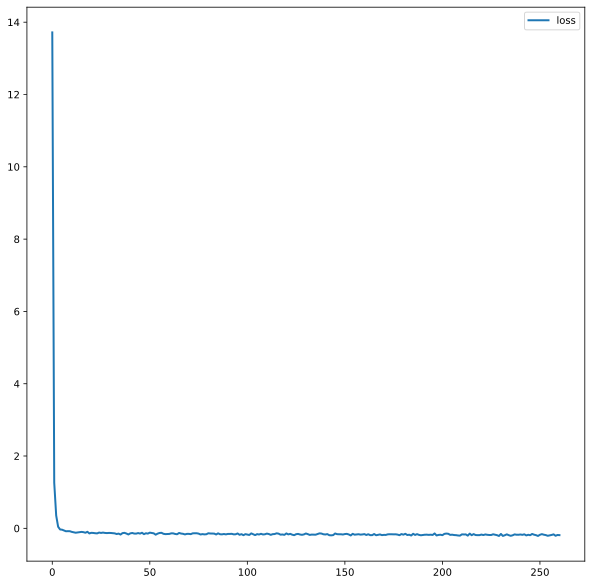

Lowest Loss: -0.2108492040541023


In [87]:
MC_losses, MC_full_losses = train(inputs, MC_model,num_epochs = 4)
plot_loss(MC_losses)

  0%|          | 0/1306 [01:08<?, ?it/s]


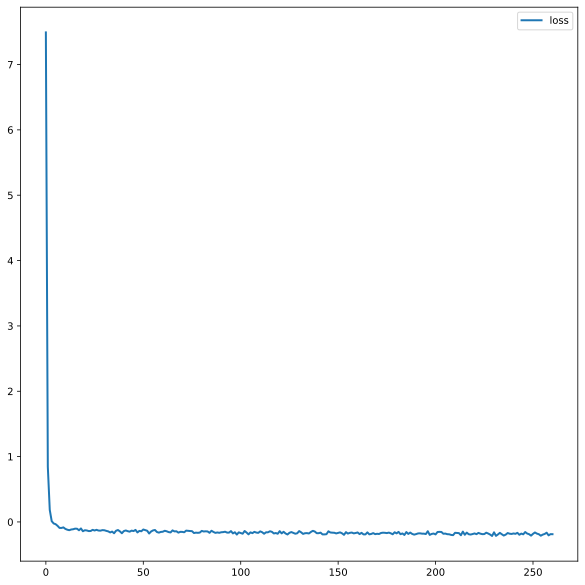

Lowest Loss: -0.21424012675415724


In [89]:
distorted_losses, distorted_full_losses = train(inputs, distorted_model,num_epochs = 4)
plot_loss(distorted_losses)

In [90]:
def transform(in_data, model, reverse = True, distorted = False):
    data_tensor = torch.zeros(in_data.num_events,12)
    model.eval()
    with torch.no_grad():
        for it in tqdm(range(in_data.max_iter), position = 0, leave=True):
            if(distorted):
                samples = in_data.sample(iteration = it, distorted = True).to(device)
            else:
                samples = in_data.sample(iteration = it).to(device)
#             test_samples = test_samples.to(device)
            if(reverse):
                output_batch = model.inverse(samples[:,:1], samples[:,1:])
            else:
                output_batch = model.forward(samples[:,:1], samples[:,1:])
            for i in range(in_data.batch_size):
                data_tensor[it*in_data.batch_size + i] = output_batch[i]
#         if((in_data.max_iter * in_data.batch_size) != in_data.num_events):
#             num_missing = in_data.num_events - (in_data.max_iter * in_data.batch_size)
#             if(distorted):
#                 end_samples = in_data.distorted_features[(in_data.max_iter * in_data.batch_size):,:12]
#             else:
#                 end_samples = in_data.data[(in_data.max_iter * in_data.batch_size):,:12]
#             end_samples = end_samples.to(device)
#             if(reverse):
#                 end_batch = model.inverse(end_samples[:,:1], end_samples[:,1:])
#             else:
#                 end_batch = model.forward(end_samples[:,:1], end_samples[:,1:])
#             for i in range(len(end_batch)):
#                 data_tensor[(in_data.max_iter * in_data.batch_size) + i] = end_batch[i]
    return data_tensor

In [91]:
normalized_MC_pT = transform(inputs, model)[:,0]
normalized_MC = torch.clone(inputs.data[:,:6])
normalized_MC[:,0] = normalized_MC_pT
normalized_distorted_pT = transform(inputs, distorted_model, distorted = True)[:,0]
normalized_distorted = torch.clone(inputs.distorted_features[:,:6])
normalized_distorted[:,0] = normalized_distorted_pT

100%|██████████| 1306/1306 [00:13<00:00, 96.11it/s]


In [92]:
normalized_distorted_obj = Latent_data(normalized_distorted, torch.empty([]))
normalized_distorted_obj.set_batch_size(100)
full_pass_distorted_pT = transform(normalized_distorted_obj, MC_model, reverse = False)[:,0]
full_pass_distorted = torch.clone(inputs.distorted_features[:,:6])
full_pass_distorted[:,0] = full_pass_distorted_pT

100%|██████████| 1306/1306 [00:13<00:00, 98.76it/s] 


In [93]:
def plot_6_histos(data_tensor, color,bins = 150, description = "none", save = False, save_loc = "plots/img.jpeg", xlim = True):
    histos, ((h11,h12,h13),(h14,h15,h16)) = plt.subplots(2,3, figsize = (10,7))
    if description == "none":
        histos.suptitle("Several 1D Histos")
    else:
        histos.suptitle(f"Several 1D Histos {description}")
    hlist = [h11,h12,h13,h14,h15,h16]
    for i in range(len(hlist)):
        hlist[i].hist(data_tensor[:,i], bins=150,color=color, density = True);
        if(xlim):
            hlist[i].set_xlim([-1,1])
    plt.show()
    if(save):
        histos.savefig(save_loc)

In [94]:
import mpl_scatter_density # adds projection='scatter_density'
from matplotlib.colors import LinearSegmentedColormap

# "Viridis-like" colormap with white background
white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
    (0, '#ffffff'),
    (1e-20, '#440053'),
    (0.2, '#404388'),
    (0.4, '#2a788e'),
    (0.6, '#21a784'),
    (0.8, '#78d151'),
    (1, '#fde624'),
], N=256)

def using_mpl_scatter_density(fig, x, y):
    ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
    density = ax.scatter_density(x, y, cmap=white_viridis)
    fig.colorbar(density, label='Number of points per pixel')

plot_fpd = torch.clone(full_pass_distorted)
plot_distorted_data = torch.clone(inputs.distorted_features)
plot_train_data = torch.clone(inputs.data)
for i in range(len(plot_fpd)):
    for j in range(6):
        if(np.isnan(plot_fpd[i,j])):
            plot_fpd[i,0] = 99999
            plot_train_data[i,0] = 99999
            plot_distorted_data[i,0] = 99999
            break
plot_fpd = plot_fpd[plot_fpd[:,0] != 99999]
plot_distorted_data = plot_distorted_data[plot_distorted_data[:,0] != 99999]
plot_train_data = plot_train_data[plot_train_data[:,0] != 99999]

In [95]:
his_fig, ((his1,his2,his3),(his21,his22,his23)) = plt.subplots(2,3,figsize = (12,8))
names = ["Proton pT", "Proton phi", "Proton theta", "Pion pT", "Pion phi", "Pion theta"]
his_fig.suptitle("Smearing Matrices with Proton pT +/-0.08 distortion")
x1 = torch.Tensor.numpy(plot_train_data[:,0])
y1 = torch.Tensor.numpy(plot_fpd[:,0])
x2 = torch.Tensor.numpy(plot_distorted_data[:,0])
y2 = torch.Tensor.numpy(plot_fpd[:,0])
x3 = torch.Tensor.numpy(plot_train_data[:,0])
y3 = torch.Tensor.numpy(plot_distorted_data[:,0])
his1.hist2d(x1,y1,bins = 200, cmap = plt.cm.jet)
his2.hist2d(x2,y2,bins = 200, cmap = plt.cm.jet)
his3.hist2d(x3,y3,bins = 200, cmap = plt.cm.jet)
his1.set_xlabel("MC vs fullpass")
his2.set_xlabel("distorted vs fullpass")
his3.set_xlabel("MC vs distorted")
his1.set_xlim(-1,1)
his2.set_xlim(-1,1)
his3.set_xlim(-1,1)
his1.set_ylim(-1,1)
his2.set_ylim(-1,1)
his3.set_ylim(-1,1)
his21.hist(inputs.data[:,0], bins = 100,color = 'r')
his21.set_xlabel("MC")
his21.set_xlim(-1,1)
his22.hist(inputs.distorted_features[:,0], bins = 100,color = 'b')
his22.set_xlabel("distorted")
his22.set_xlim(-1,1)
his23.hist(full_pass_distorted[:,0], bins = 100,color = 'g')
his23.set_xlabel("fullpass")
his23.set_xlim(-1,1)
his_fig.savefig("plots/NF_conditional/july_17_0_08_distortion.jpeg")